# Detecting a fish in an image

In [3]:
%matplotlib inline
from __future__ import division
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd

import argparse
import datetime
import cv2
import os

import itertools as itt


import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import collections
import pdb


from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn import preprocessing
from sklearn.preprocessing import OneHotEncoder,LabelEncoder
from sklearn import linear_model,decomposition
from sklearn.feature_extraction import DictVectorizer
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score,r2_score
from sklearn.ensemble import RandomForestClassifier
from sklearn import svm
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis

from sklearn.model_selection import StratifiedKFold
from itertools import cycle
from sklearn.metrics import roc_curve, auc
from scipy import interp
import scipy

from sklearn.ensemble import ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression,SGDClassifier
from sklearn.linear_model import RidgeCV
from sklearn.cross_validation import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import cross_val_score, ShuffleSplit

from scipy.sparse import coo_matrix, hstack ,vstack

import gc

print(gc.collect())

import xgboost as xgb




0


/home/venkat/anaconda2/lib/python2.7/site-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


# Detect a person standing in an image

image =  (183, 275, 3)
55 36
image =  (183, 275, 3)
110 73
image =  (183, 275, 3)
165 109
image =  (183, 275, 3)
220 146
scaled image =  (146, 220, 3)
[INFO] detection took: 0.068787s
[[ 82  13  65 130]]
[[ 4.42920646]]


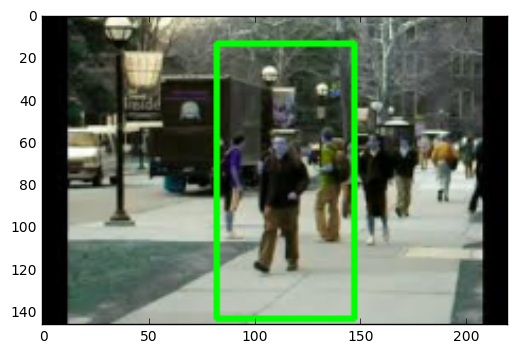

descriptor size =  3780
image =  (183, 275, 3)
275 183
scaled image =  (183, 275, 3)
[INFO] detection took: 0.266739s
[[108  39  69 138]]
[[ 70.50171367]]


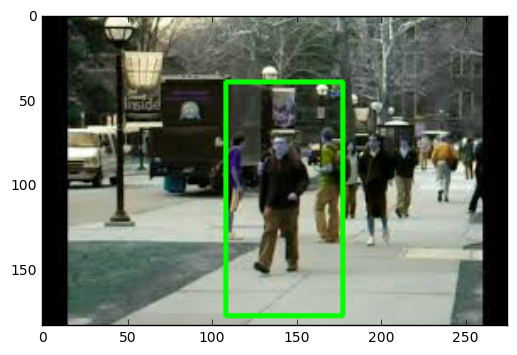

descriptor size =  3780
image =  (183, 275, 3)
330 219
scaled image =  (219, 330, 3)
[INFO] detection took: 1.393797s
[[206  52  68 137]
 [135  65  71 143]]
[[   8.43576571]
 [ 239.65859764]]


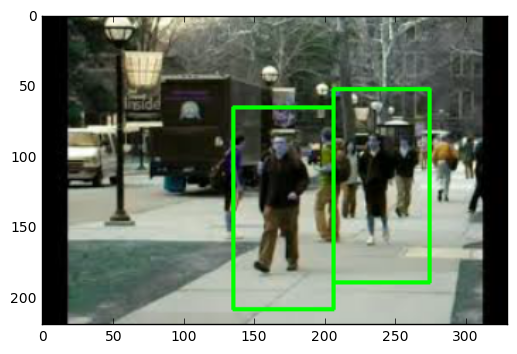

descriptor size =  3780
image =  (183, 275, 3)
385 256
scaled image =  (256, 385, 3)
[INFO] detection took: 4.114109s
[[205  74  67 134]
 [245  80  67 134]
 [159  81  79 158]]
[[  31.9625328 ]
 [  74.5067347 ]
 [ 286.32661027]]


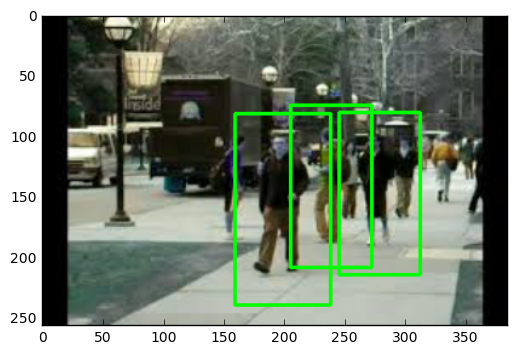

descriptor size =  3780
image =  (183, 275, 3)
440 292
scaled image =  (292, 440, 3)
[INFO] detection took: 7.185419s
[[ 32  73  71 143]
 [237  92  72 144]
 [280  96  72 144]
 [181  93  90 181]
 [141  95  67 134]]
[[   3.55790566]
 [  55.97182175]
 [ 128.82779125]
 [ 263.93352075]
 [   2.14534079]]


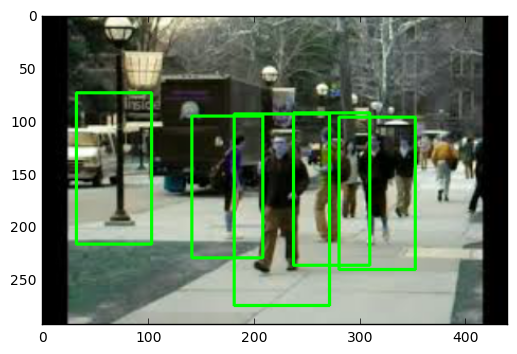

descriptor size =  3780
image =  (183, 275, 3)
495 329
scaled image =  (329, 495, 3)
[INFO] detection took: 10.274405s
[[ 37  88  77 155]
 [350 105  67 134]
 [165 122  67 134]
 [269 111  76 153]
 [316 108  81 162]
 [394  93  64 128]
 [203 104 102 204]]
[[   2.84210802]
 [  40.62955863]
 [   6.92872227]
 [  69.22811719]
 [ 132.83507836]
 [   3.3447578 ]
 [ 244.25274905]]


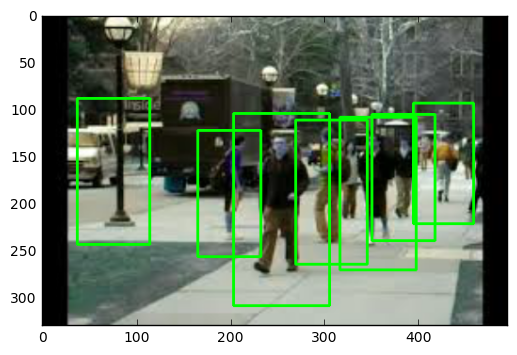

descriptor size =  3780


In [172]:
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
 


for ss in np.arange(0.2,2,0.2):
    image = cv2.imread('images.jpeg')
    height, width = image.shape[:2]
    print 'image = ',image.shape
    width=int(width*ss)
    height=int(height*ss)
    print width,height
    if width>64 and height > 128:
        try:
            image=cv2.resize(image, (width , height), cv2.INTER_LINEAR).astype(np.uint8)
            # image = imutils.resize(image, width=min(400, image.shape[1]))
            print 'scaled image = ',image.shape

            winStride=(1,1)
            padding=(0, 0)
            scale=1.05
            meanShift=1

            start = datetime.datetime.now()
            (rects, weights) = hog.detectMultiScale(image, winStride=winStride,scale=1.05,padding=padding, useMeanshiftGrouping=meanShift)
            print( "[INFO] detection took: {}s".format( (datetime.datetime.now() - start).total_seconds()) )

            print rects
            print weights
            # draw the original bounding boxes
            for (x, y, w, h) in rects:
                cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

            # show the output image
            plt.imshow( image)
            plt.show()
            # cv2.waitKey(0)
            print "descriptor size = ",hog.getDescriptorSize()
        except:
            pass

# Histogram of Gradients features

image =  (128, 128, 3)
(3780, 1)
3780


<Container object of 3780 artists>

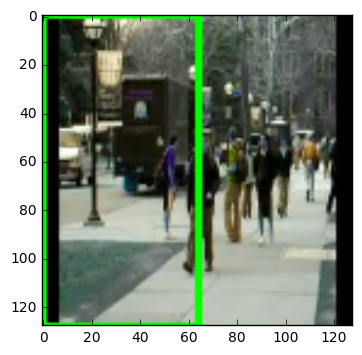

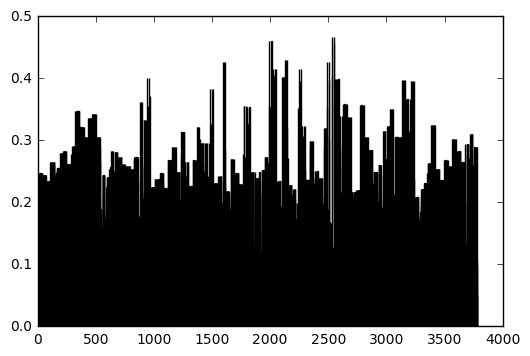

In [10]:
# import cv2
image = cv2.imread('images.jpeg')
height=128
width=128
image = cv2.resize(image, (width,height), cv2.INTER_LINEAR).astype(np.uint8)


print 'image = ',image.shape
win_width=64
win_height=128
winSize = (win_width,win_height)
blockSize = (16,16)
blockStride = (8,8)
cellSize = (8,8)
nbins = 9
derivAperture = 1
winSigma = 4.
histogramNormType = 0
L2HysThreshold = 2.0000000000000001e-01
gammaCorrection = 0
nlevels = 64
hog = cv2.HOGDescriptor(winSize,blockSize,blockStride,cellSize,nbins,derivAperture,winSigma,
                        histogramNormType,L2HysThreshold,gammaCorrection,nlevels)
#compute(img[, winStride[, padding[, locations]]]) -> descriptors
winStride = (8,8)
padding = (8,8)
location = [0,0]
hist= hog.compute(image,winStride,locations=((location[0],location[1]),))

plt.figure()
cv2.rectangle(image, (location[0], location[1]), (location[0] + winSize[0], location[1] + winSize[1]), (0, 255, 0), 2)
plt.imshow(image)


print hist.shape
print hog.getDescriptorSize()
hist
plt.figure()
plt.bar(range(len(hist)),hist,width=0.7)

## Histogram of gradients computed from X and Y derivattives

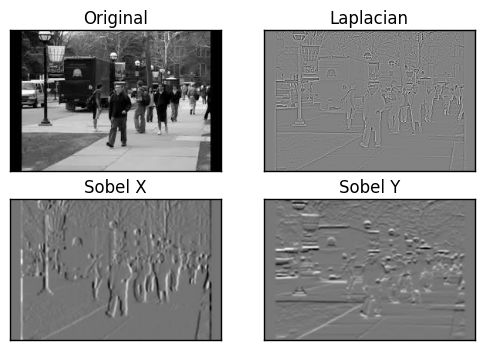

In [3]:


img = cv2.imread('images.jpeg',0)

laplacian = cv2.Laplacian(img,cv2.CV_64F)
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)

plt.subplot(2,2,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])
plt.show()

# Training SVM with HOG features of fish

## Input data of positive and negative samples

(64, 128, 3)


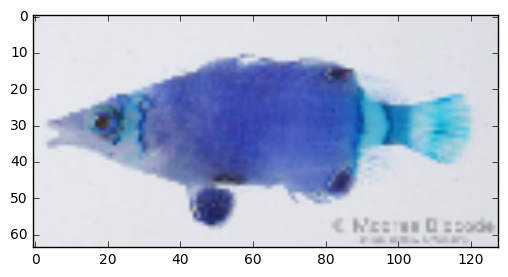

(64, 128, 3)


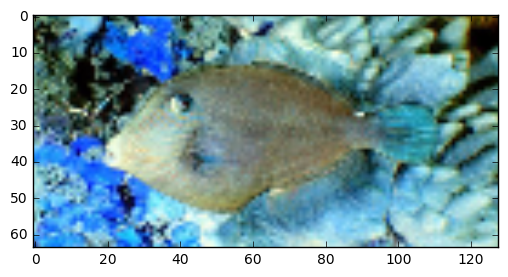

(64, 128, 3)


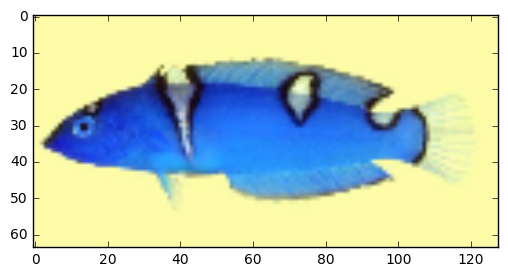

(64, 128, 3)


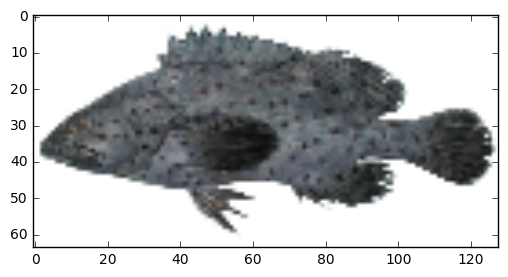

(64, 128, 3)


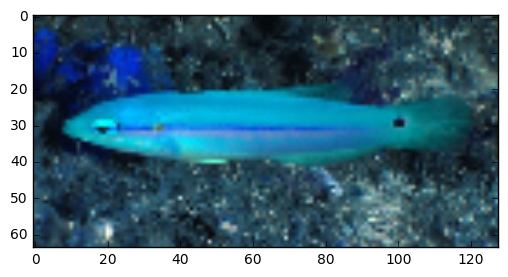

(64, 128, 3)


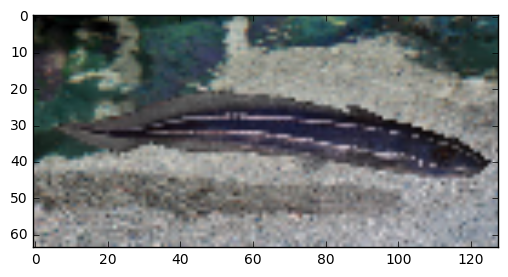

(64, 128, 3)


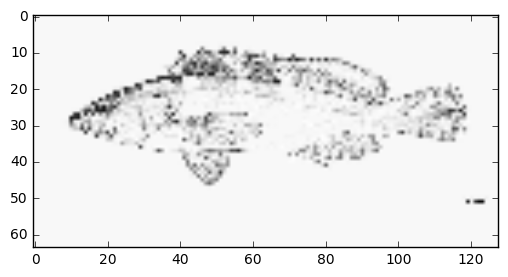

(64, 128, 3)


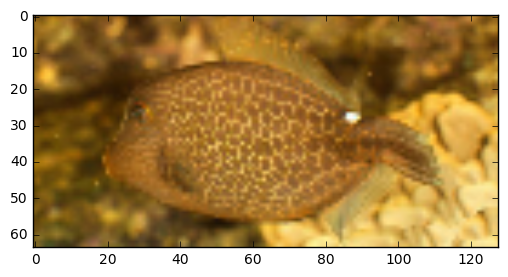

(64, 128, 3)


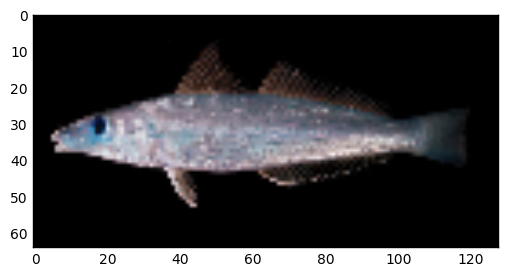

(64, 128, 3)


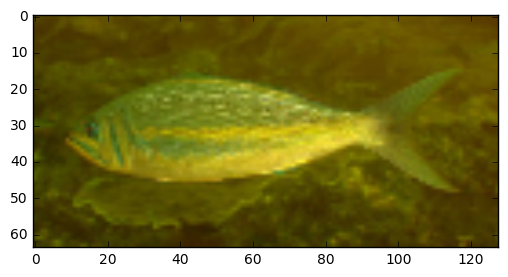

(64, 128, 3)


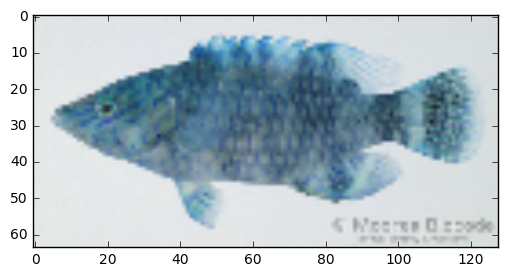

(64, 128, 3)


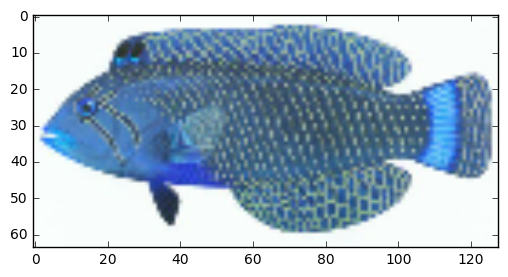

In [4]:
import os

rawimages='QUT_fish_data/images/raw_images'
croppedimages='QUT_fish_data/images/cropped'
os.listdir(rawimages)

height=64
width= 128

files=os.listdir(rawimages)
i=0
for ff in files:
#     plt.figure()
    try:
        imagepath=os.path.join(rawimages,ff)
        img = cv2.imread(imagepath)
        img = cv2.resize(img, (width,height), cv2.INTER_LINEAR).astype(np.uint8)
    except:
        print "error with ",ff
    print img.shape
    plt.imshow(img)
    plt.show()
    if i>10:
        break
    i=i+1
    
    

In [67]:
def GetHOGfeatures_image(image,win_width=128,win_height=64):
    if image.shape[0]!=win_height or image.shape[1]!=win_width :
        return np.nan
    
    # height=128
    # width=128
    # image = cv2.resize(image, (width,height), cv2.INTER_LINEAR).astype(np.uint8)

    
    
    winSize = (win_width,win_height)
    blockSize = (16,16)
    blockStride = (8,8)
    cellSize = (8,8)
    nbins = 9
    derivAperture = 1
    winSigma = 4.
    histogramNormType = 0
    L2HysThreshold = 2.0000000000000001e-01
    gammaCorrection = 0
    nlevels = 64
    hog = cv2.HOGDescriptor(winSize,blockSize,blockStride,cellSize,nbins,derivAperture,winSigma,
                            histogramNormType,L2HysThreshold,gammaCorrection,nlevels)

    winStride = (8,8)
    padding = (8,8)
    hist= hog.compute(image,winStride)
    


    return hist


hist=GetHOGfeatures_image(img)

In [190]:
win_width=128
win_height=64
winSize = (win_width,win_height)
blockSize = (16,16)
blockStride = (8,8)
cellSize = (8,8)
nbins = 9
derivAperture = 1
winSigma = 4.
histogramNormType = 0
L2HysThreshold = 2.0000000000000001e-01
gammaCorrection = 0
nlevels = 64
hog = cv2.HOGDescriptor(winSize,blockSize,blockStride,cellSize,nbins,derivAperture,winSigma,
                        histogramNormType,L2HysThreshold,gammaCorrection,nlevels)

hog.save("fishhog.xml")
hog = cv2.HOGDescriptor("fishhog.xml")


In [78]:
import os

rawimages='QUT_fish_data/images/raw_images'
croppedimages='QUT_fish_data/images/cropped'
os.listdir(rawimages)

height=64
width= 128

files=os.listdir(rawimages)
i=0
X_true_poitive=np.array([])
for ff in files:
#     plt.figure()
    try:
        imagepath=os.path.join(rawimages,ff)
        img = cv2.imread(imagepath)
        
        img = cv2.resize(img, (width,height), cv2.INTER_LINEAR).astype(np.uint8)
        hist=GetHOGfeatures_image(img)

        if X_true_poitive.size==0:
            X_true_poitive=hist.reshape(1,len(hist))[0]
        else:
            X_true_poitive=np.vstack([X_true_poitive,hist.reshape(1,len(hist))[0] ])

    except:
        print "error with ",ff
#     print img.shape
#     plt.imshow(img)
#     plt.show()
#     if i>10:
#         break
#     i=i+1
    
    

 error with  .DS_Store


In [158]:
X_true_poitive.shape

(4405, 3780)

In [155]:
# getting false negatives
height=64
width= 128

otherspath='train/OTHER'
files=os.listdir(otherspath)
file_filepaths=itt.izip( files,  itt.imap( lambda x: os.path.join(x[0],x[1])  ,itt.izip(itt.repeat(otherspath),files) )  )

X_false_negative=np.array([])

for ff,ffpath in file_filepaths:
    print ff, ffpath
    
    image = cv2.imread(ffpath)
#     height=128
#     width=128
#     image = cv2.resize(image, (width,height), cv2.INTER_LINEAR).astype(np.uint8)
    rndh=np.random.randint(0,image.shape[0]-height,30)
    rndw=np.random.randint(0,image.shape[1]-width,30)
    crop_images=zip(rndw,rndh)
#     print image.shape
    
#     plt.figure()
#     plt.imshow(image)
    
    for w,h in crop_images:
#         plt.figure()
#         print h,w
        img=image[h:h+height,w:w+width,:]
#         print img.shape
#         plt.imshow( img )
#         plt.show()
        
        hist=GetHOGfeatures_image(img)
        
        if X_false_negative.size==0:
            X_false_negative=hist.reshape(1,len(hist))[0]
        else:
            X_false_negative=np.vstack([X_false_negative,hist.reshape(1,len(hist))[0] ])

        
    

img_06028.jpg train/OTHER/img_06028.jpg
img_07365.jpg train/OTHER/img_07365.jpg
img_02680.jpg train/OTHER/img_02680.jpg
img_04565.jpg train/OTHER/img_04565.jpg
img_05274.jpg train/OTHER/img_05274.jpg
img_01957.jpg train/OTHER/img_01957.jpg
img_05502.jpg train/OTHER/img_05502.jpg
img_07405.jpg train/OTHER/img_07405.jpg
img_07139.jpg train/OTHER/img_07139.jpg
img_06199.jpg train/OTHER/img_06199.jpg
img_07073.jpg train/OTHER/img_07073.jpg
img_05756.jpg train/OTHER/img_05756.jpg
img_01400.jpg train/OTHER/img_01400.jpg
img_06419.jpg train/OTHER/img_06419.jpg
img_06818.jpg train/OTHER/img_06818.jpg
img_03526.jpg train/OTHER/img_03526.jpg
img_05114.jpg train/OTHER/img_05114.jpg
img_06708.jpg train/OTHER/img_06708.jpg
img_07042.jpg train/OTHER/img_07042.jpg
img_01483.jpg train/OTHER/img_01483.jpg
img_00183.jpg train/OTHER/img_00183.jpg
img_02198.jpg train/OTHER/img_02198.jpg
img_05490.jpg train/OTHER/img_05490.jpg
img_01356.jpg train/OTHER/img_01356.jpg
img_02407.jpg train/OTHER/img_02407.jpg


In [156]:
X_false_negative.shape

(8970, 3780)

In [159]:
X_train=np.vstack([X_true_poitive,X_false_negative])
Y_train=np.hstack([np.ones( X_true_poitive.shape[0] ), np.zeros( X_false_negative.shape[0] ) ] )

In [3]:
print X_train.shape
print Y_train.shape

(13375, 3780)
(13375,)


In [162]:
np.savez('FishObjectDetect_train',X_train=X_train,Y_train=Y_train)

In [2]:
XX=np.load('FishObjectDetect_train.npz')
X_train=XX['X_train']
Y_train=XX['Y_train']
print X_train.shape
print Y_train.shape

(13375, 3780)
(13375,)


# Training SVM on fish HOG features

In [3]:

def GetMetrics(clf,X,Y,Ytest,Ypred,doroc=True):
    print "\n***** Accuracy Score *****\n"
    print metrics.accuracy_score(Ytest,Ypred)
    print "\n***** Classification report ***** \n"
    print metrics.classification_report(Ytest,Ypred)
    print "\n***** Confusion Matrix ***** \n"
    print '\x1b[1;31m'+ str(metrics.confusion_matrix(Ytest,Ypred) )+'\x1b[0m'
    print "\n***** r2_score ***** \n"
    print r2_score(Ytest,Ypred)
    
    if doroc:
        print "\n***** ROC cure ***** \n"
        cv = StratifiedKFold(n_splits=6)
        mean_tpr = 0.0
        mean_fpr = np.linspace(0, 1, 100)
        colors = cycle(['cyan', 'indigo', 'seagreen', 'yellow', 'blue', 'darkorange'])
        lw = 2

        i = 0
        plt.figure()
        for (train, test), color in zip(cv.split(X, Y), colors):
            probas_ = clf.fit(X[train], Y[train]).predict_proba(X[test])
            # Compute ROC curve and area the curve
            fpr, tpr, thresholds = roc_curve(Y[test], probas_[:, 1])
            mean_tpr += interp(mean_fpr, fpr, tpr)
            mean_tpr[0] = 0.0
            roc_auc = auc(fpr, tpr)
            plt.plot(fpr, tpr, lw=lw, color=color,
                     label='ROC fold %d (area = %0.2f)' % (i, roc_auc))

            i += 1

        plt.plot([0, 1], [0, 1], linestyle='--', lw=lw, color='k',
                 label='Luck')

        mean_tpr /= cv.get_n_splits(X, Y)
        mean_tpr[-1] = 1.0
        mean_auc = auc(mean_fpr, mean_tpr)
        plt.plot(mean_fpr, mean_tpr, color='g', linestyle='--',
                 label='Mean ROC (area = %0.2f)' % mean_auc, lw=lw)

        plt.xlim([-0.05, 1.05])
        plt.ylim([-0.05, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver operating characteristic example')
        plt.legend(loc="lower right")
        plt.show()

    #     cv = ShuffleSplit(n_splits=3, test_size=0.3, random_state=0)
    #     scores = cross_val_score(clf, Xtrain, Ytrain, cv=cv)
    #     print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))
    

Xtrain, Xtest,Ytrain, Ytest = train_test_split(X_train,Y_train,test_size=0.33,random_state=45)

print Xtrain.shape
print Xtest.shape



(8961, 3780)
(4414, 3780)


In [6]:
print 'LinearSVC'
clf_linsvc = svm.LinearSVC( C=1)
clf_linsvc.fit(Xtrain,Ytrain)
Ypred=clf_linsvc.predict(Xtest)
print "Performance"
GetMetrics(clf_linsvc,Xtrain,Ytrain,Ytest,Ypred,doroc=False)


LinearSVC
Performance

***** Accuracy Score *****

0.95808790213

***** Classification report ***** 

             precision    recall  f1-score   support

        0.0       0.97      0.96      0.97      2931
        1.0       0.93      0.95      0.94      1483

avg / total       0.96      0.96      0.96      4414


***** Confusion Matrix ***** 

[[2826  105]
 [  80 1403]]

***** r2_score ***** 

0.812134476184


In [7]:
print clf_linsvc.coef_.shape
print clf_linsvc.intercept_
fishsvm=np.vstack([clf_linsvc.coef_.reshape(-1,1),clf_linsvc.intercept_ ])
np.save('fishsvm_parameters',fishsvm)

(1, 3780)
[-4.01072327]


In [3]:
fishsvm=np.load('fishsvm_parameters.npy')

# Detecting fishes in general pictures

------------------------------------------------------------------------------------------------------------------------------------------------------
train/ALB/img_07868.jpg
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.066394s


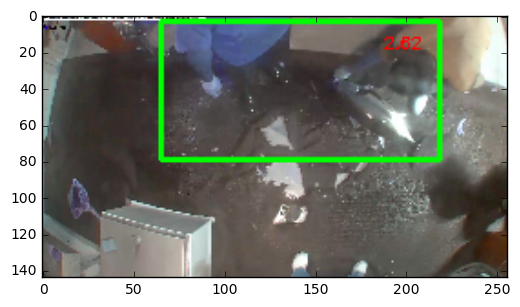

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.005252s


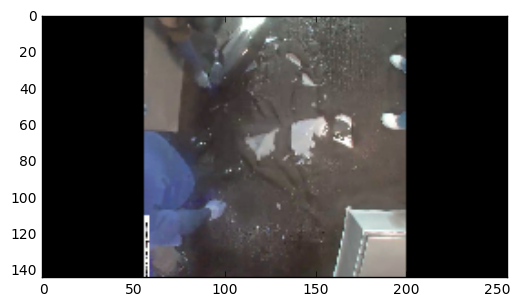

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.035992s


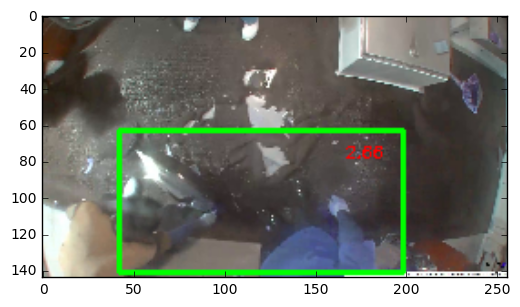

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.005322s


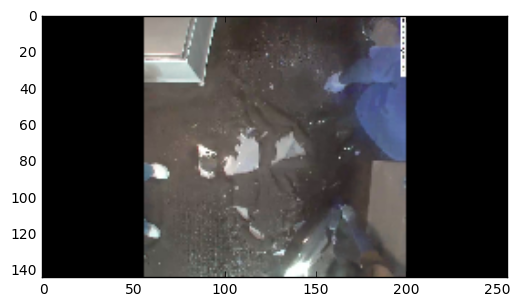

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 7.903071s


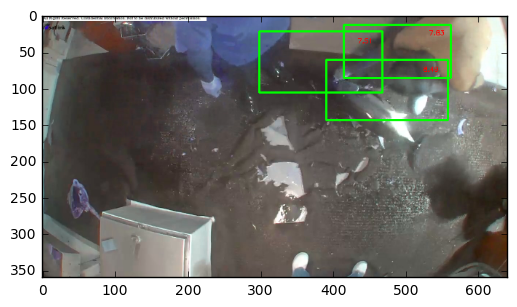

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 0.381576s


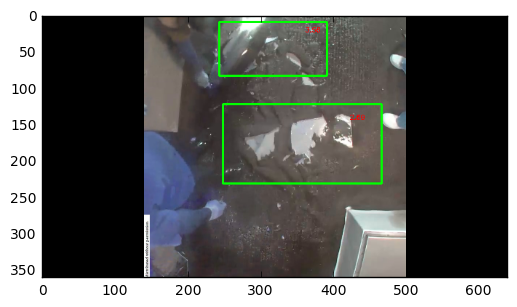

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 7.443919s


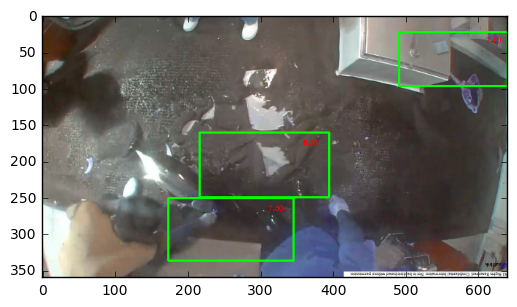

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 0.570153s


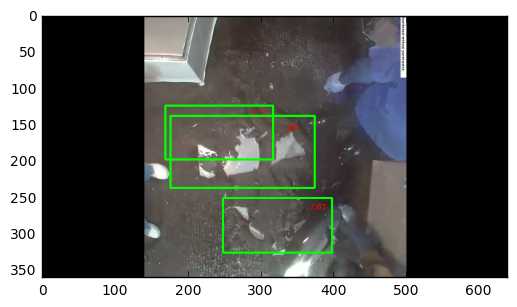

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 138.956478s


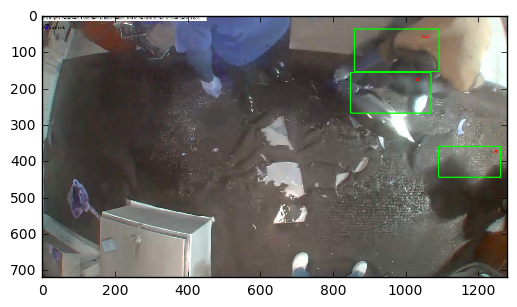

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 7.686906s


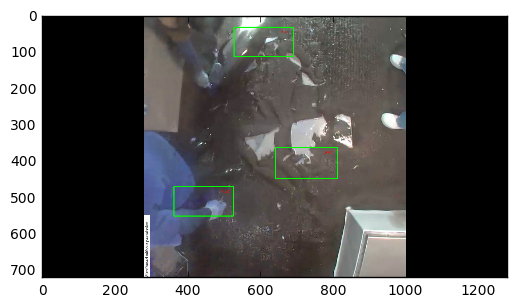

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 134.334159s


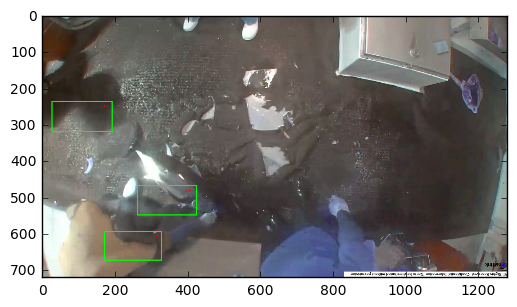

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 12.740616s


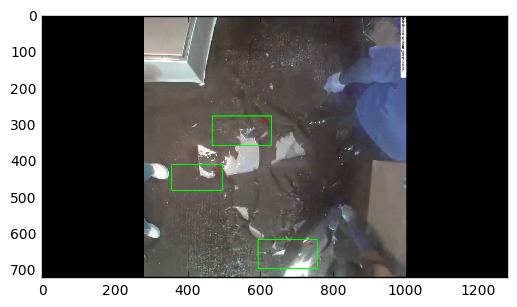

descriptor size =  3780
------------------------------------------------------------------------------------------------------------------------------------------------------
train/ALB/img_04570.jpg
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.004824s


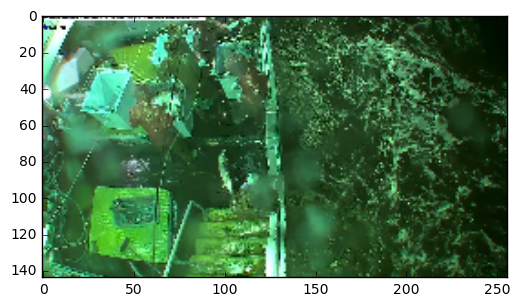

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.00523s


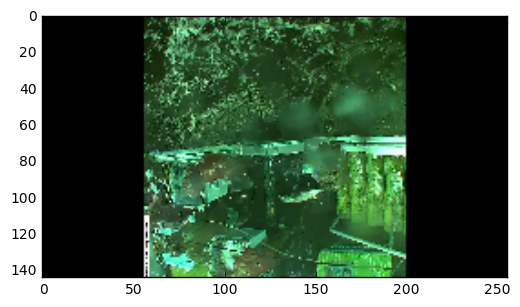

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.005566s


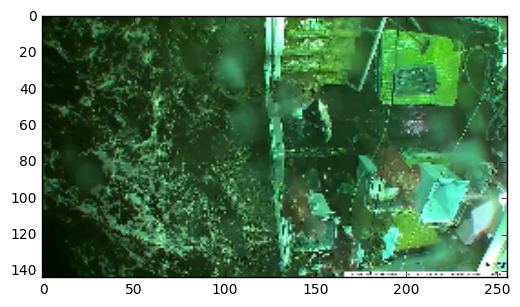

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.005383s


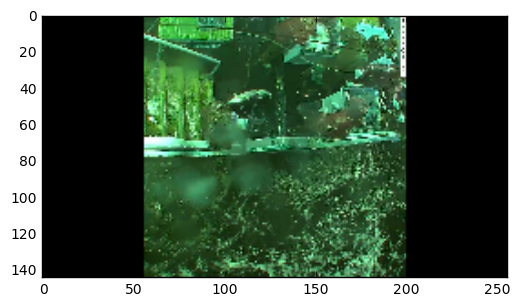

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 1.42686s


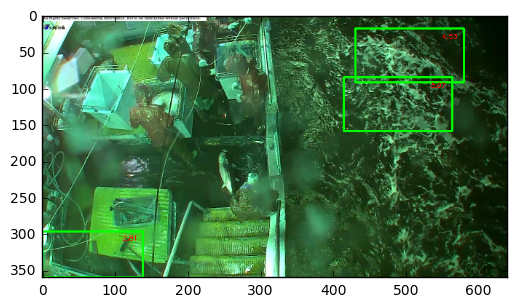

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 0.759003s


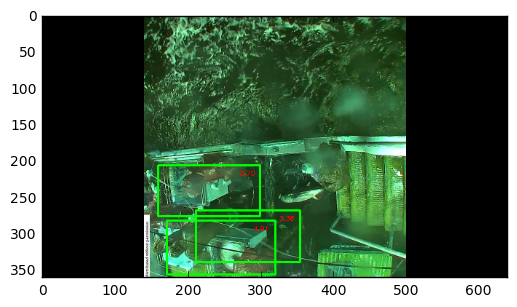

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 1.914383s


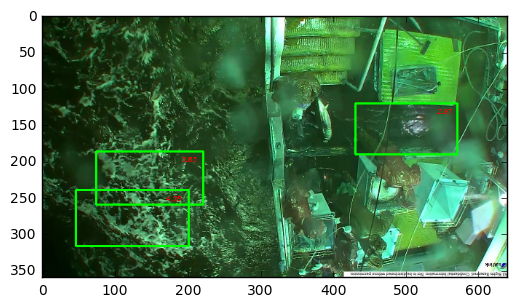

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 2.662197s


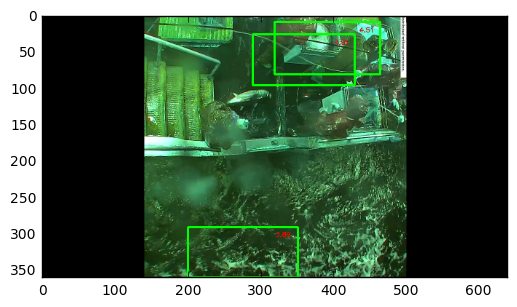

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 110.022482s


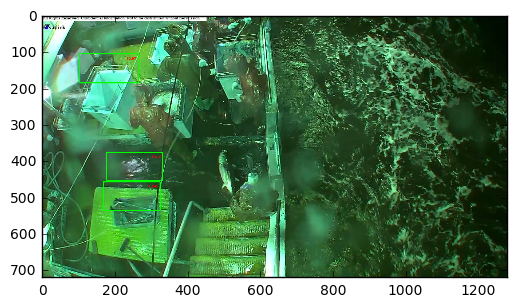

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 48.042868s


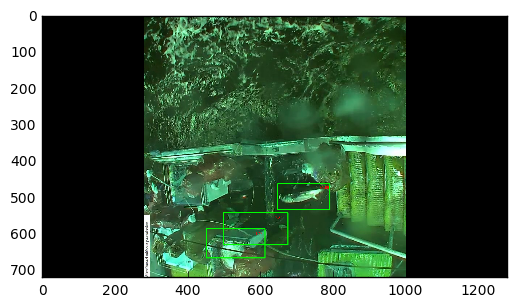

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 98.099979s


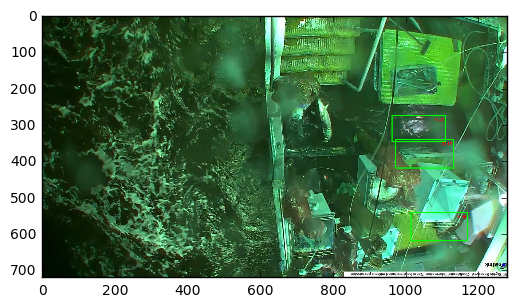

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 74.288031s


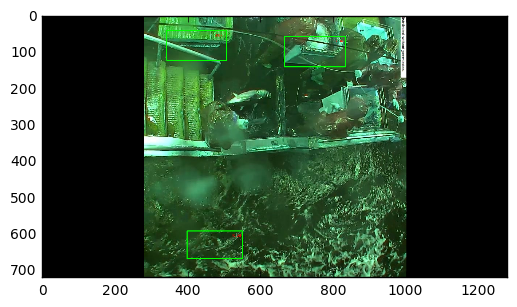

descriptor size =  3780
------------------------------------------------------------------------------------------------------------------------------------------------------
train/ALB/img_00576.jpg
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.017757s


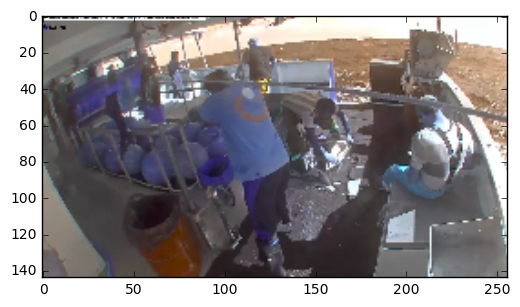

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.006402s


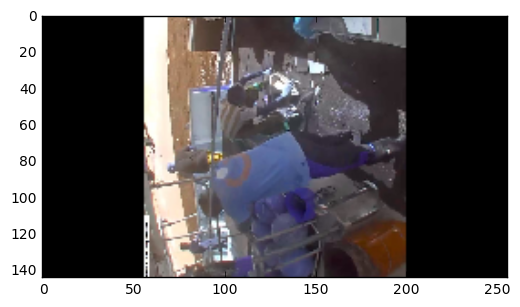

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.02017s


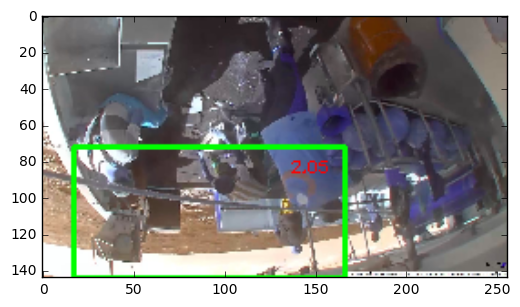

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.005712s


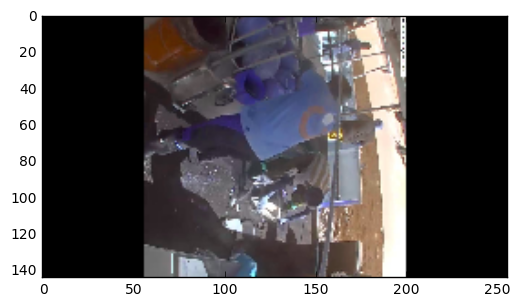

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 1.020923s


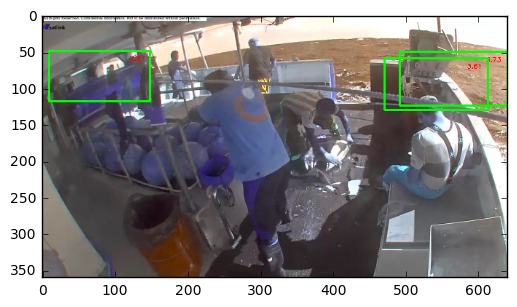

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 2.392624s


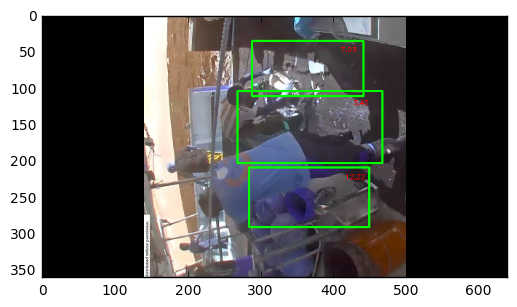

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 1.06645s


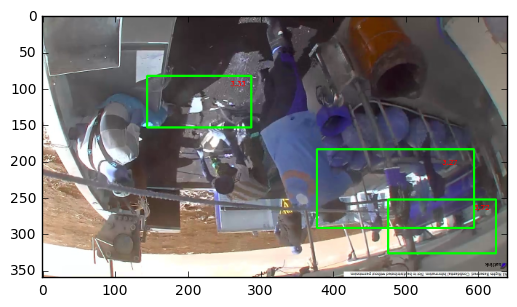

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 3.436881s


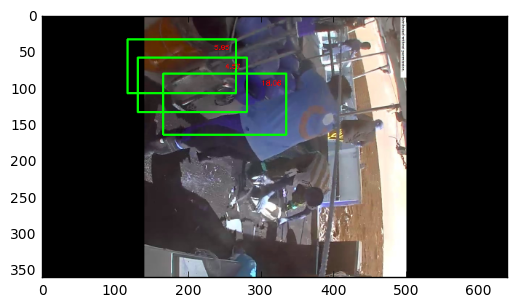

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 26.832291s


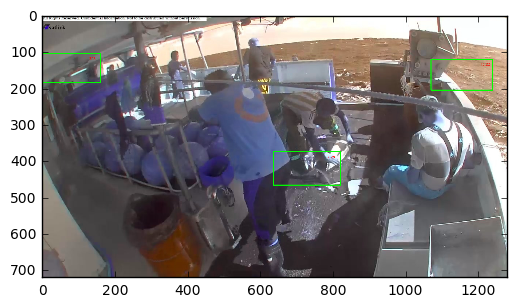

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 44.969263s


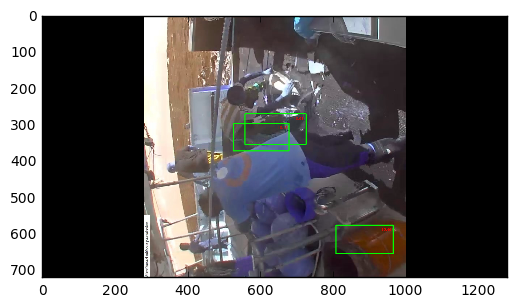

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 29.121444s


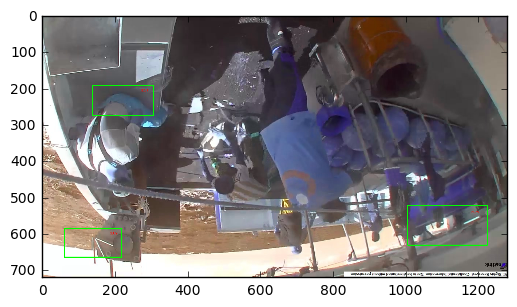

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 60.545164s


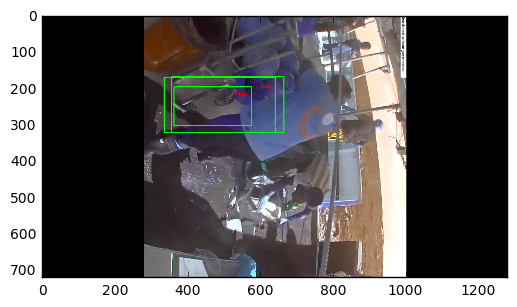

descriptor size =  3780
------------------------------------------------------------------------------------------------------------------------------------------------------
train/ALB/img_07470.jpg
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.117469s


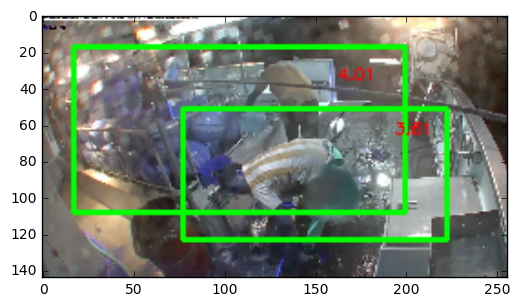

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.006485s


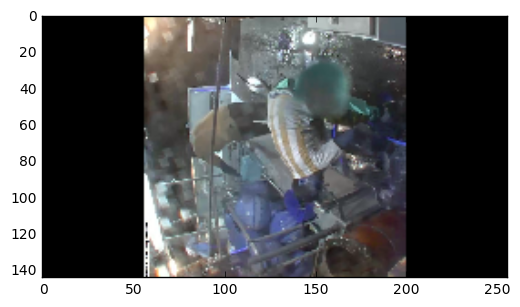

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.03931s


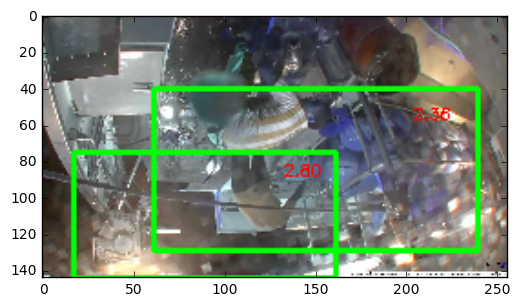

descriptor size =  3780
image =  (720, 1280, 3)
256 144
scaled image =  (144, 256, 3)
[INFO] detection took: 0.005429s


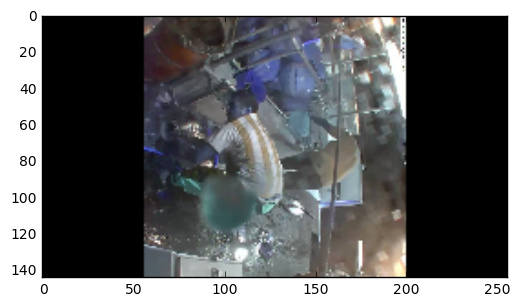

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 4.17134s


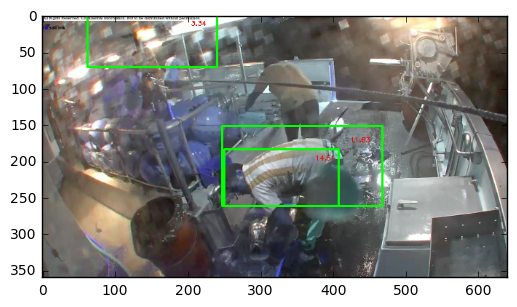

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 0.654975s


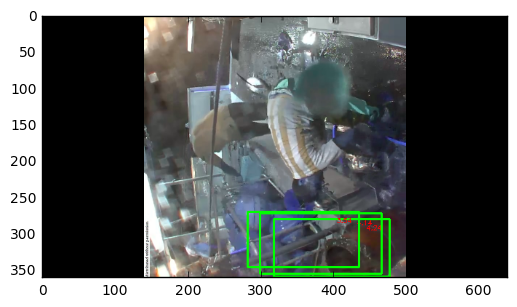

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 7.992803s


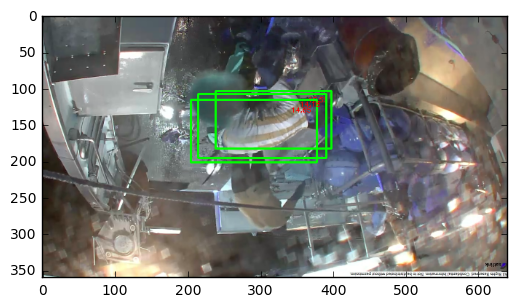

descriptor size =  3780
image =  (720, 1280, 3)
640 360
scaled image =  (360, 640, 3)
[INFO] detection took: 2.350177s


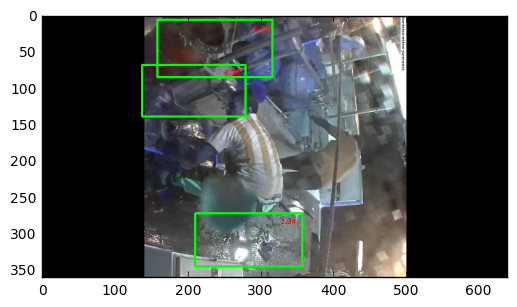

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 90.634413s


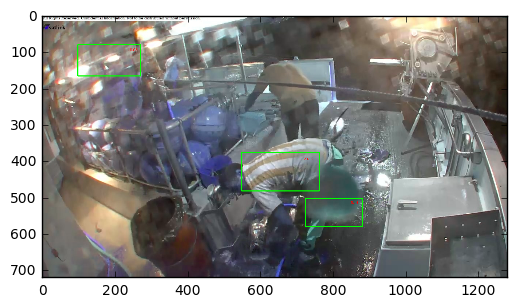

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 23.538255s


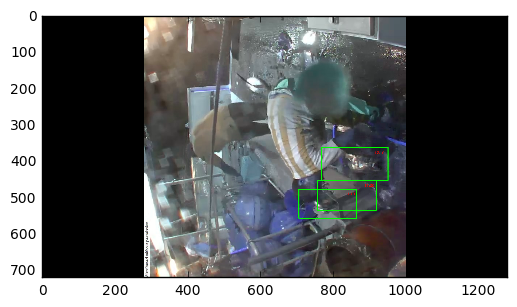

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 95.267753s


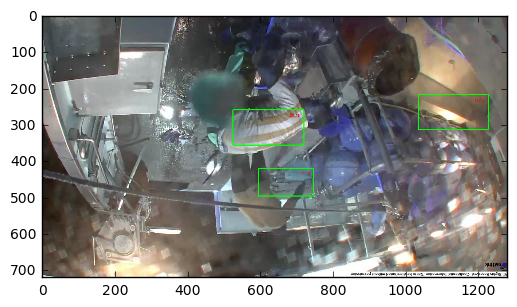

descriptor size =  3780
image =  (720, 1280, 3)
1280 720
scaled image =  (720, 1280, 3)
[INFO] detection took: 43.120911s


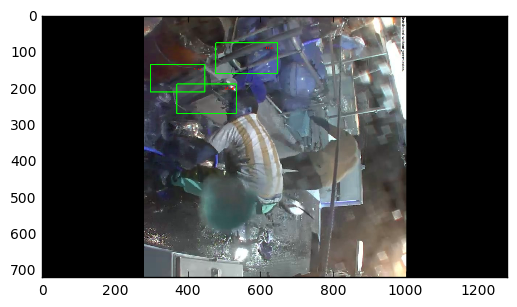

descriptor size =  3780
------------------------------------------------------------------------------------------------------------------------------------------------------
train/ALB/img_06458.jpg
image =  (718, 1276, 3)
255 143
scaled image =  (143, 255, 3)
[INFO] detection took: 0.212531s


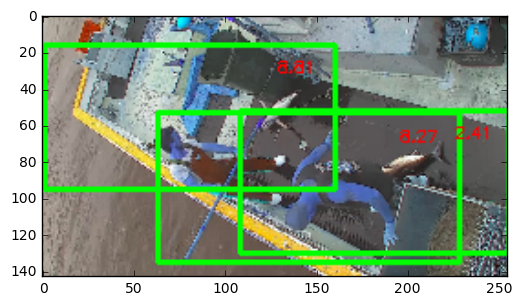

descriptor size =  3780
image =  (718, 1276, 3)
255 143
scaled image =  (143, 255, 3)
[INFO] detection took: 0.005299s


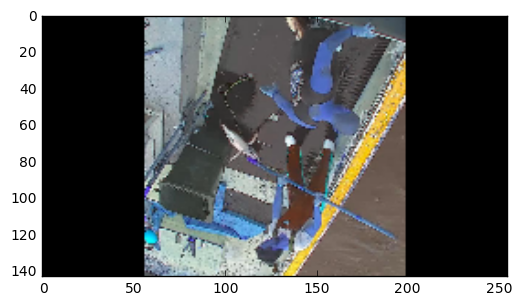

descriptor size =  3780
image =  (718, 1276, 3)
255 143
scaled image =  (143, 255, 3)
[INFO] detection took: 0.35092s


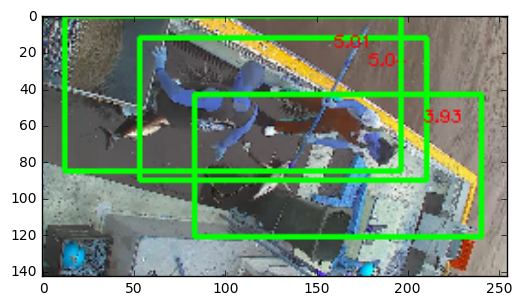

descriptor size =  3780
image =  (718, 1276, 3)
255 143
scaled image =  (143, 255, 3)
[INFO] detection took: 0.006949s


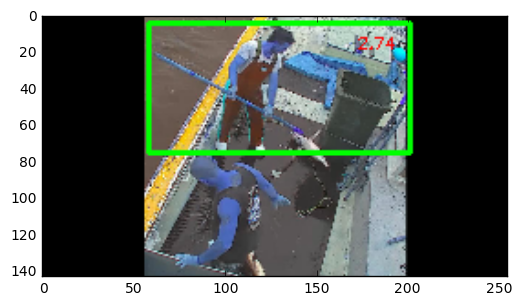

descriptor size =  3780
image =  (718, 1276, 3)
638 359
scaled image =  (359, 638, 3)
[INFO] detection took: 23.003806s


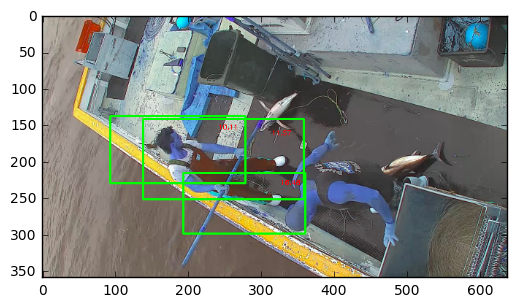

descriptor size =  3780
image =  (718, 1276, 3)
638 359
scaled image =  (359, 638, 3)
[INFO] detection took: 2.254005s


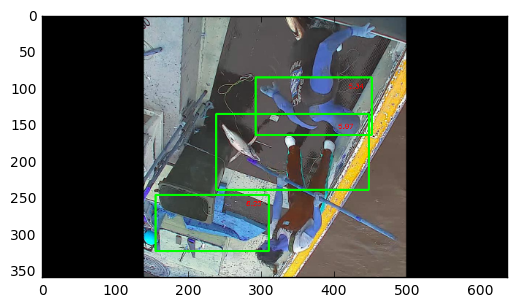

descriptor size =  3780
image =  (718, 1276, 3)
638 359
scaled image =  (359, 638, 3)
[INFO] detection took: 22.964355s


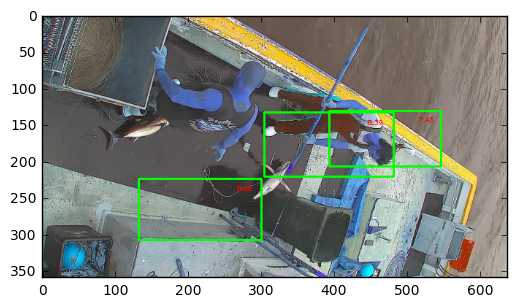

descriptor size =  3780
image =  (718, 1276, 3)
638 359
scaled image =  (359, 638, 3)
[INFO] detection took: 3.561102s


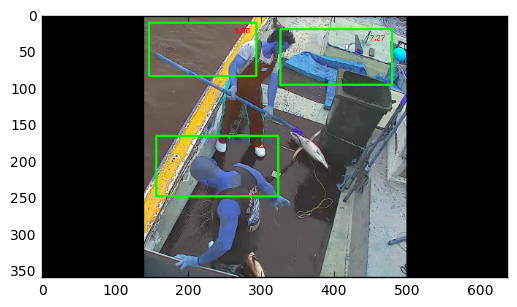

descriptor size =  3780
image =  (718, 1276, 3)
1276 718
scaled image =  (718, 1276, 3)
[INFO] detection took: 594.531216s


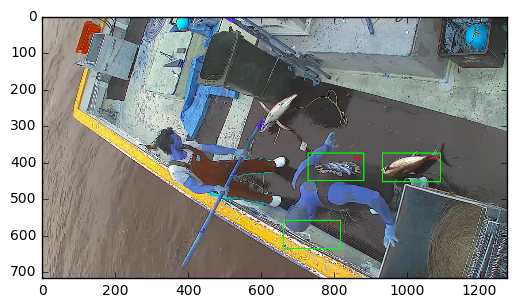

descriptor size =  3780
image =  (718, 1276, 3)
1276 718
scaled image =  (718, 1276, 3)
[INFO] detection took: 88.874164s


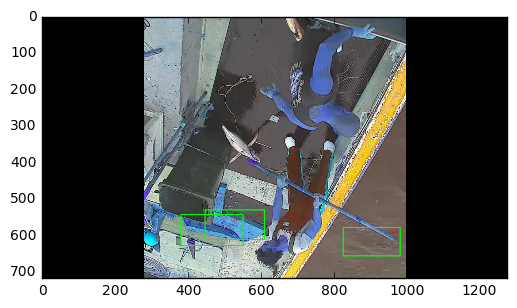

descriptor size =  3780
image =  (718, 1276, 3)
1276 718
scaled image =  (718, 1276, 3)
[INFO] detection took: 526.434496s


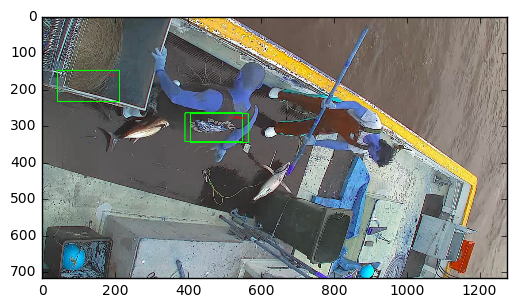

descriptor size =  3780
image =  (718, 1276, 3)
1276 718
scaled image =  (718, 1276, 3)
[INFO] detection took: 169.858967s


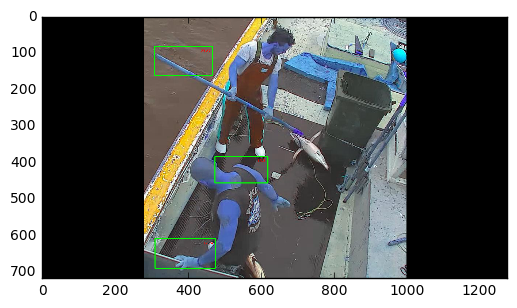

descriptor size =  3780
------------------------------------------------------------------------------------------------------------------------------------------------------
train/ALB/img_03985.jpg
image =  (924, 1280, 3)
256 184
scaled image =  (184, 256, 3)
[INFO] detection took: 0.02915s


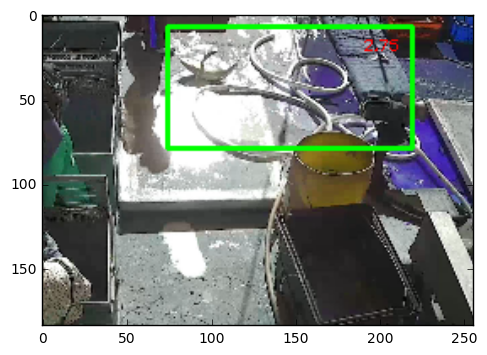

descriptor size =  3780
image =  (924, 1280, 3)
256 184
scaled image =  (184, 256, 3)
[INFO] detection took: 0.006398s


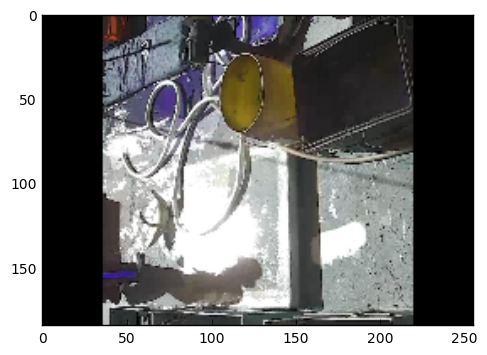

descriptor size =  3780
image =  (924, 1280, 3)
256 184
scaled image =  (184, 256, 3)
[INFO] detection took: 0.016504s


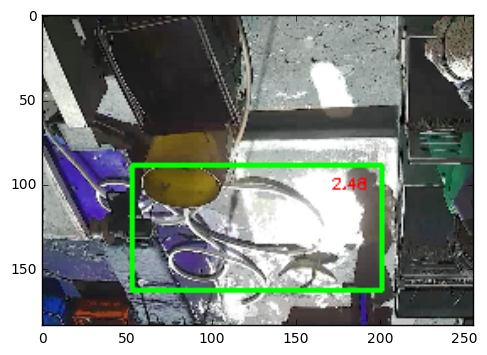

descriptor size =  3780
image =  (924, 1280, 3)
256 184
scaled image =  (184, 256, 3)
[INFO] detection took: 0.006803s


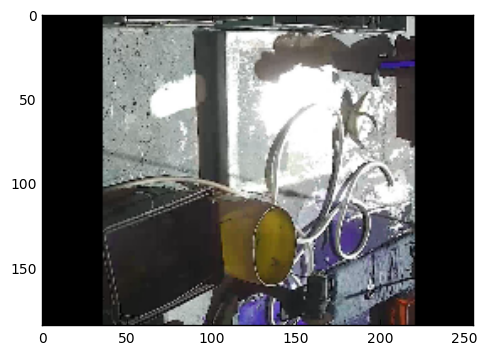

descriptor size =  3780
image =  (924, 1280, 3)
640 462
scaled image =  (462, 640, 3)
[INFO] detection took: 3.369753s


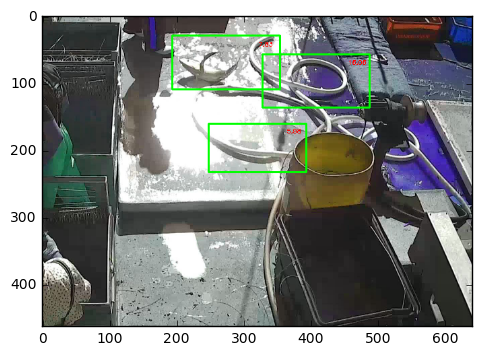

descriptor size =  3780
image =  (924, 1280, 3)
640 462
scaled image =  (462, 640, 3)
[INFO] detection took: 0.638946s


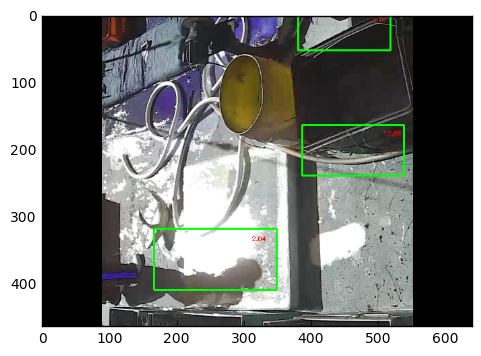

descriptor size =  3780
image =  (924, 1280, 3)
640 462
scaled image =  (462, 640, 3)
[INFO] detection took: 3.761266s


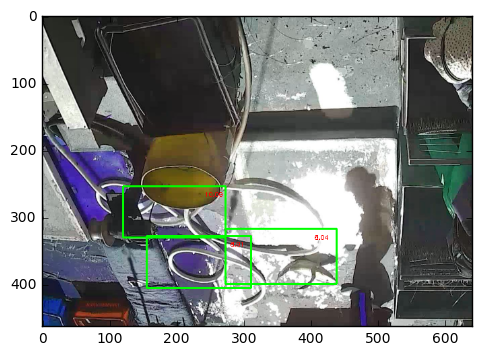

descriptor size =  3780
image =  (924, 1280, 3)
640 462
scaled image =  (462, 640, 3)
[INFO] detection took: 1.187401s


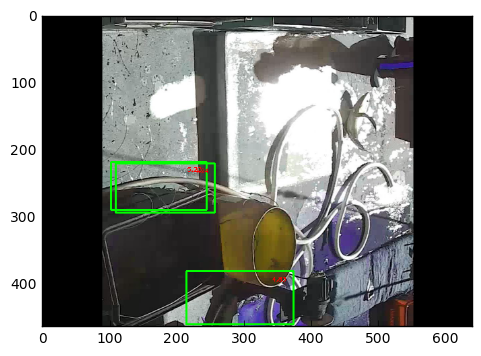

descriptor size =  3780
image =  (924, 1280, 3)
1280 924
scaled image =  (924, 1280, 3)
[INFO] detection took: 107.665411s


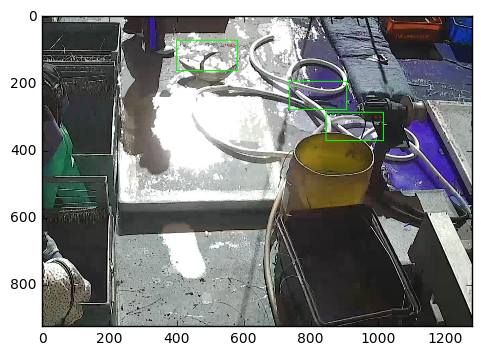

descriptor size =  3780
image =  (924, 1280, 3)
1280 924
scaled image =  (924, 1280, 3)
[INFO] detection took: 51.226905s


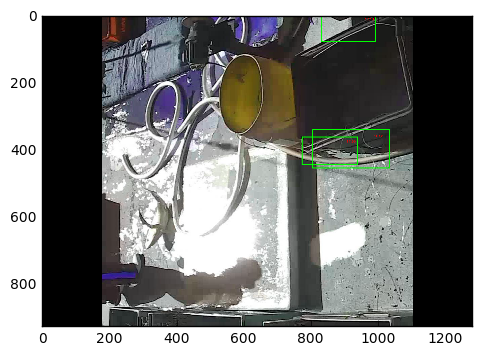

descriptor size =  3780
image =  (924, 1280, 3)
1280 924
scaled image =  (924, 1280, 3)
[INFO] detection took: 100.970146s


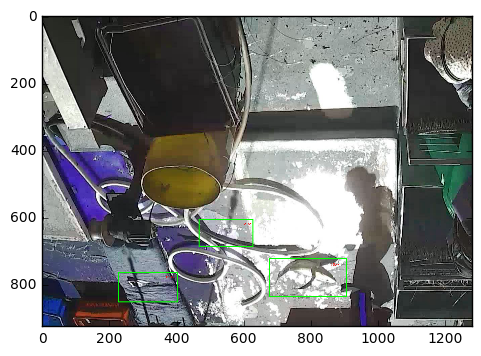

descriptor size =  3780
image =  (924, 1280, 3)
1280 924
scaled image =  (924, 1280, 3)
[INFO] detection took: 39.562259s


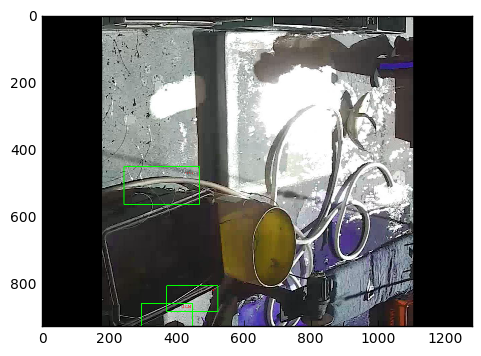

descriptor size =  3780
------------------------------------------------------------------------------------------------------------------------------------------------------
train/ALB/img_05332.jpg
image =  (670, 1192, 3)
238 134
scaled image =  (134, 238, 3)
[INFO] detection took: 0.020688s


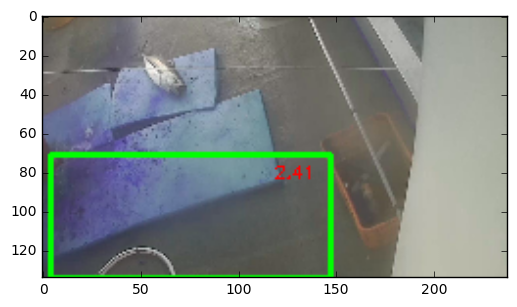

descriptor size =  3780
image =  (670, 1192, 3)
238 134
scaled image =  (134, 238, 3)
[INFO] detection took: 0.004502s


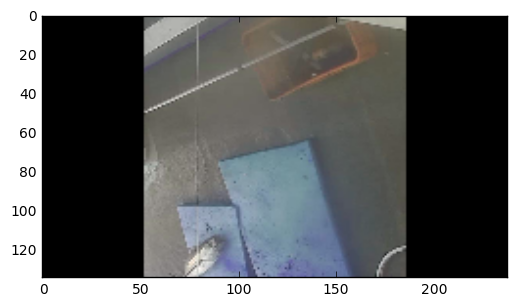

descriptor size =  3780
image =  (670, 1192, 3)
238 134
scaled image =  (134, 238, 3)
[INFO] detection took: 0.012578s


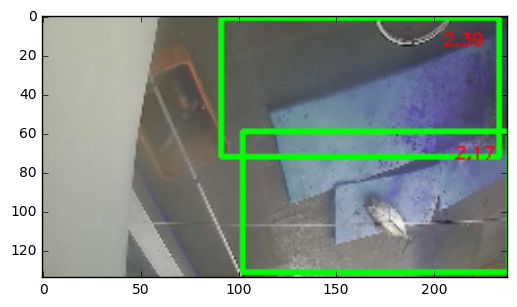

descriptor size =  3780
image =  (670, 1192, 3)
238 134
scaled image =  (134, 238, 3)
[INFO] detection took: 0.004391s


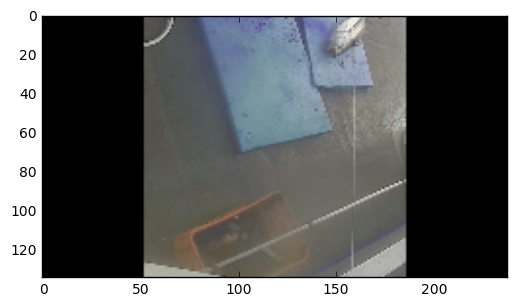

descriptor size =  3780
image =  (670, 1192, 3)
596 335
scaled image =  (335, 596, 3)
[INFO] detection took: 2.510065s


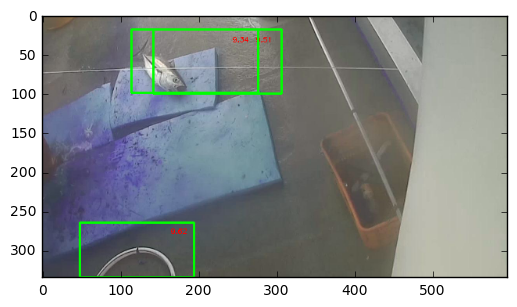

descriptor size =  3780
image =  (670, 1192, 3)
596 335
scaled image =  (335, 596, 3)
[INFO] detection took: 2.221272s


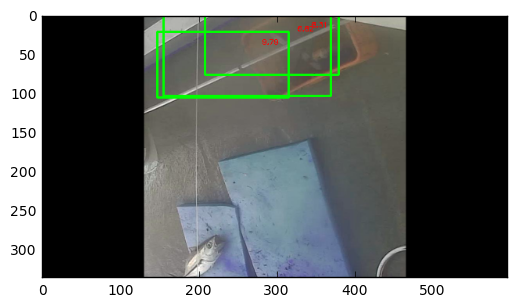

descriptor size =  3780
image =  (670, 1192, 3)
596 335
scaled image =  (335, 596, 3)
[INFO] detection took: 6.428424s


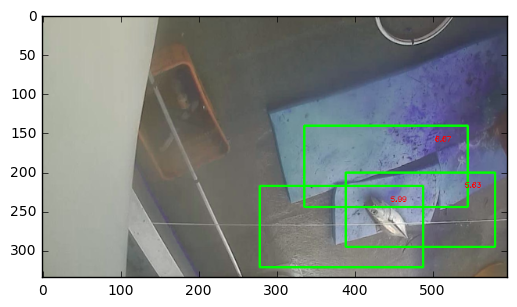

descriptor size =  3780
image =  (670, 1192, 3)
596 335
scaled image =  (335, 596, 3)
[INFO] detection took: 1.460149s


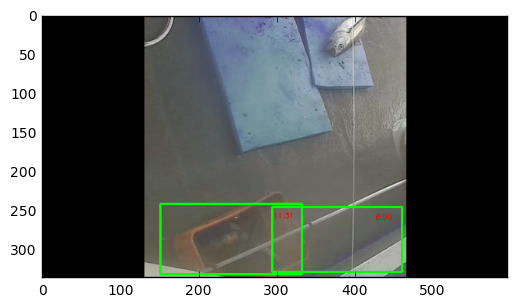

descriptor size =  3780
image =  (670, 1192, 3)
1192 670
scaled image =  (670, 1192, 3)
[INFO] detection took: 71.546302s


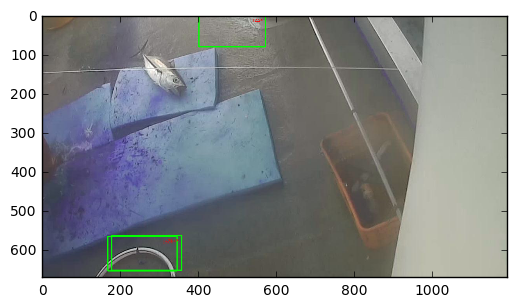

descriptor size =  3780
image =  (670, 1192, 3)
1192 670
scaled image =  (670, 1192, 3)
[INFO] detection took: 14.040896s


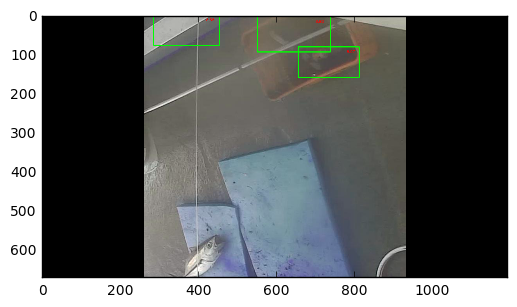

descriptor size =  3780
image =  (670, 1192, 3)
1192 670
scaled image =  (670, 1192, 3)
[INFO] detection took: 84.743873s


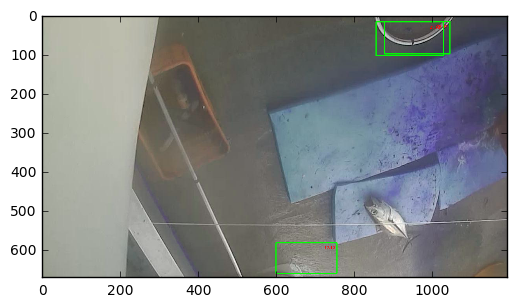

descriptor size =  3780
image =  (670, 1192, 3)
1192 670
scaled image =  (670, 1192, 3)
[INFO] detection took: 20.83776s


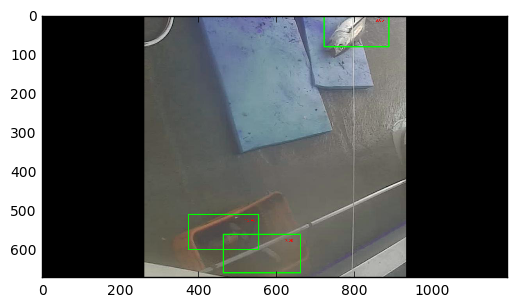

descriptor size =  3780
------------------------------------------------------------------------------------------------------------------------------------------------------
train/ALB/img_05985.jpg
image =  (718, 1276, 3)
255 143
scaled image =  (143, 255, 3)
[INFO] detection took: 0.294848s


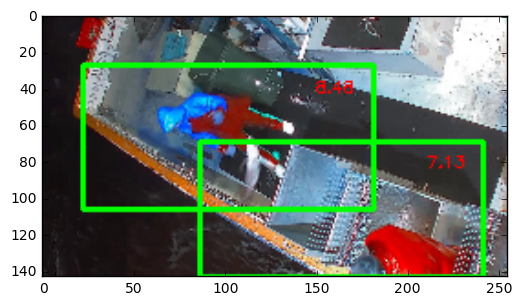

descriptor size =  3780
image =  (718, 1276, 3)
255 143
scaled image =  (143, 255, 3)
[INFO] detection took: 0.00785s


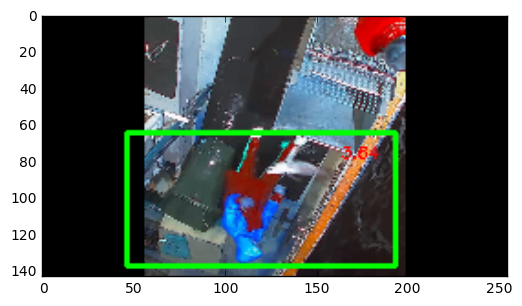

descriptor size =  3780
image =  (718, 1276, 3)
255 143
scaled image =  (143, 255, 3)
[INFO] detection took: 0.385495s


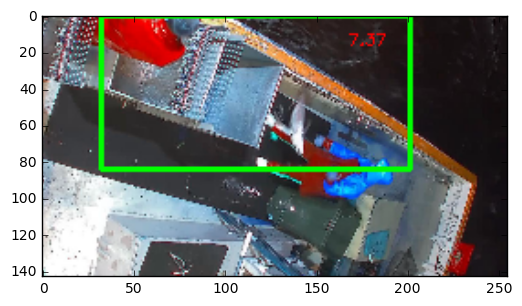

descriptor size =  3780
image =  (718, 1276, 3)
255 143
scaled image =  (143, 255, 3)
[INFO] detection took: 0.006355s


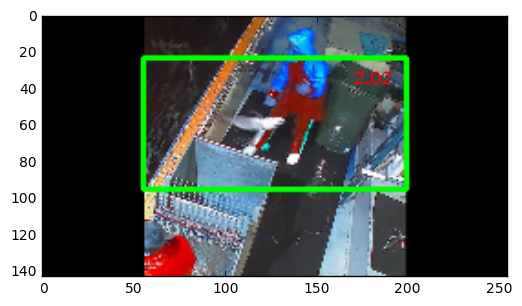

descriptor size =  3780
image =  (718, 1276, 3)
638 359
scaled image =  (359, 638, 3)
[INFO] detection took: 27.977594s


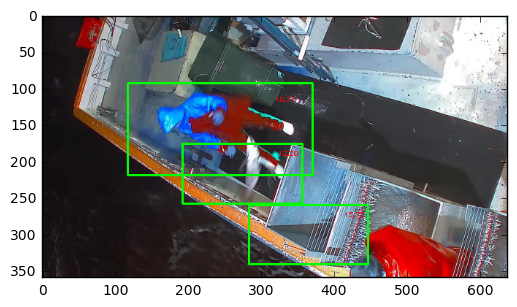

descriptor size =  3780
image =  (718, 1276, 3)
638 359
scaled image =  (359, 638, 3)
[INFO] detection took: 2.843638s


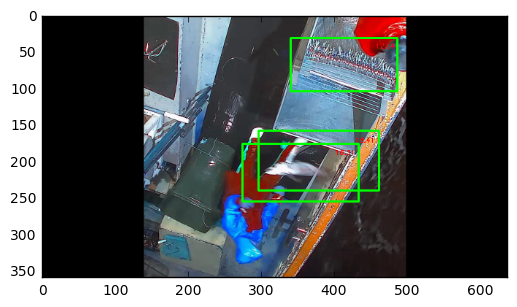

descriptor size =  3780
image =  (718, 1276, 3)
638 359
scaled image =  (359, 638, 3)
[INFO] detection took: 22.12116s


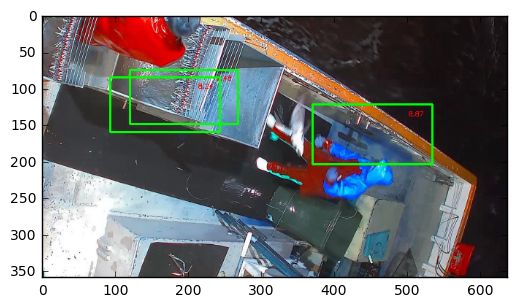

descriptor size =  3780
image =  (718, 1276, 3)
638 359
scaled image =  (359, 638, 3)
[INFO] detection took: 3.76635s


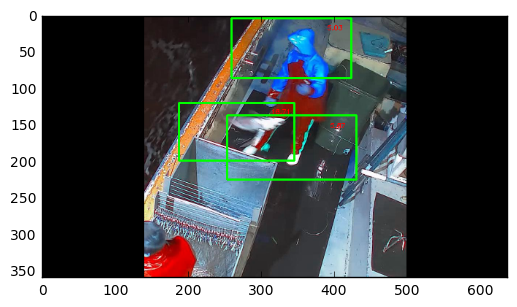

descriptor size =  3780
image =  (718, 1276, 3)
1276 718
scaled image =  (718, 1276, 3)
[INFO] detection took: 322.619848s


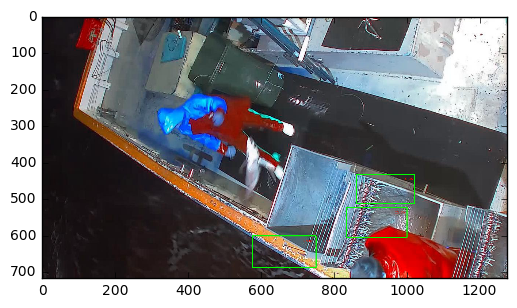

descriptor size =  3780
image =  (718, 1276, 3)
1276 718
scaled image =  (718, 1276, 3)
[INFO] detection took: 230.788834s


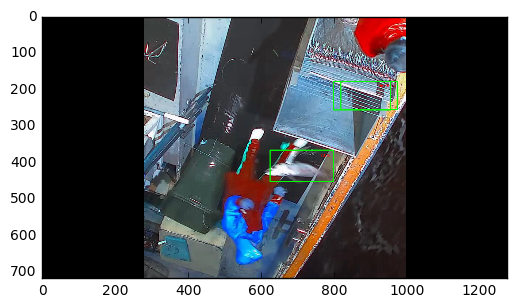

descriptor size =  3780
image =  (718, 1276, 3)
1276 718
scaled image =  (718, 1276, 3)


In [ ]:
hog = cv2.HOGDescriptor("fishhog.xml")
hog.setSVMDetector(fishsvm)

files=os.listdir('train/ALB')

for fl in files:
    testimage=os.path.join('train/ALB',fl)
    print "---"*50
    print testimage

    for ss in [0.2,0.5,1]:
        image1 = cv2.imread(testimage)
        rows,cols = image1.shape[:2]

        M = cv2.getRotationMatrix2D((cols/2,rows/2),90,1)
        image2 = cv2.warpAffine(image1,M,(cols,rows))
        
        M = cv2.getRotationMatrix2D((cols/2,rows/2),180,1)
        image3 = cv2.warpAffine(image1,M,(cols,rows))
        
        M = cv2.getRotationMatrix2D((cols/2,rows/2),270,1)
        image4 = cv2.warpAffine(image1,M,(cols,rows))
        
        for image in [image1,image2,image3,image4]:
            ht, wh = image.shape[:2]
            print 'image = ',image.shape
            wh=int(wh*ss)
            ht=int(ht*ss)
            print wh,ht
            if wh>128 and ht > 64:
#                 try:
                image=cv2.resize(image, (wh , ht), cv2.INTER_LINEAR).astype(np.uint8)


                # image = imutils.resize(image, width=min(400, image.shape[1]))
                print 'scaled image = ',image.shape

                winStride=(8,8)
                padding=(16, 16)
                scale=1.05
                meanShift=1

                start = datetime.datetime.now()
                (rects, weights) = hog.detectMultiScale(image, winStride=winStride,scale=1.05,padding=padding, useMeanshiftGrouping=meanShift)
                print( "[INFO] detection took: {}s".format( (datetime.datetime.now() - start).total_seconds()) )

                df=pd.DataFrame(zip(rects,weights),columns=['rects','wts'])
                df.sort_values(by='wts',ascending=False,inplace=True)
                df=df.iloc[:3]
                # draw the original bounding boxes
                for inddf in df.index:
                    (x, y, w, h) = df.loc[inddf,'rects']
                    wts = df.loc[inddf,'wts']

                    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
                    cv2.putText(image,"%.2f"%wts, (x+int(w*0.8),y+int(h*0.2) ), cv2.FONT_HERSHEY_SIMPLEX, 0.3, 255)
    #                 font = cv2.FONT_HERSHEY_SIMPLEX
    #                 cv2.putText(img,'OpenCV Tuts!',(x,y), font, 1, (200,255,155), 2, cv2.LINE_AA)

                # show the output image
                plt.imshow( image)
                plt.show()
                # cv2.waitKey(0)
                print "descriptor size = ",hog.getDescriptorSize()
#                 except:
#                     pass
                
                

## Training Gradient Boosting trees on fish hog features

In [170]:
print 'XGBOOST - tree'
dtrain = xgb.DMatrix(Xtrain, label=Ytrain)
dtest = xgb.DMatrix(Xtest)

param = {'max_depth':10, 'eta':0.02, 'silent':1, 'objective':'binary:logistic' }
param['nthread'] = 4
param['eval_metric'] = 'auc'
param['subsample'] = 0.7
param['colsample_bytree']= 0.7
param['min_child_weight'] = 0
param['booster'] = "gblinear"

watchlist  = [(dtrain,'train')]
num_round = 300
early_stopping_rounds=10

clf_xgb = xgb.train(param, dtrain, num_round, watchlist,early_stopping_rounds=early_stopping_rounds)

Ypred = clf_xgb.predict(dtest)
thresh=0.5
vfunc = np.vectorize(lambda x: 1 if x>=thresh else 0)
ypred=list(vfunc(Ypred))


GetMetrics(clf_xgb,Xtrain,Ytrain,Ytest,ypred,doroc=False)


XGBOOST - tree
[0]	train-auc:0.974301
Will train until train-auc hasn't improved in 10 rounds.
[1]	train-auc:0.978891
[2]	train-auc:0.982336
[3]	train-auc:0.984976
[4]	train-auc:0.98693
[5]	train-auc:0.98836
[6]	train-auc:0.989467
[7]	train-auc:0.990319
[8]	train-auc:0.990994
[9]	train-auc:0.991561
[10]	train-auc:0.992038
[11]	train-auc:0.992441
[12]	train-auc:0.99279
[13]	train-auc:0.993101
[14]	train-auc:0.993385
[15]	train-auc:0.993635
[16]	train-auc:0.993869
[17]	train-auc:0.994083
[18]	train-auc:0.994273
[19]	train-auc:0.994448
[20]	train-auc:0.994614
[21]	train-auc:0.994769
[22]	train-auc:0.994916
[23]	train-auc:0.995053
[24]	train-auc:0.995182
[25]	train-auc:0.995302
[26]	train-auc:0.995418
[27]	train-auc:0.99553
[28]	train-auc:0.995637
[29]	train-auc:0.995739
[30]	train-auc:0.995836
[31]	train-auc:0.99593
[32]	train-auc:0.996024
[33]	train-auc:0.996113
[34]	train-auc:0.996197
[35]	train-auc:0.996278
[36]	train-auc:0.996356
[37]	train-auc:0.996431
[38]	train-auc:0.996505
[39]	tr

# Using Convolution neural networks to extract features
- Use VGG16 model to extract features
- Then use SVM or gradient boosting trees